# **Object Detection with YOLO11 Utilizing the Pascal VOC Dataset**

In this notebook, the [YOLO11](https://docs.ultralytics.com/models/yolo11/) model from [Ultralytics](https://www.ultralytics.com/) is fine-tuned, which is the latest and most advanced deep learning model in the YOLO series for real-time object detection. The YOLO11 models are pretrained on the [COCO](https://docs.ultralytics.com/datasets/detect/coco/#coco-pretrained-models) dataset, which consists of 200,000 images and 80 object categories, providing a strong foundation for general object detection tasks. The fine-tuning is performed using the [Pascal VOC 2012](https://public.roboflow.com/object-detection/pascal-voc-2012) dataset, downloaded from the official [Roboflow](https://roboflow.com/) platform. This dataset contains 17,112 images and 20 object categories, where the images can include one or more objects from different classes. Pascal VOC 2012 is widely used as a benchmark for evaluating current object detection models.

## **Imports**

In [ ]:
# Installation of the Ultralytics library
!pip install ultralytics -q

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 881.7/881.7 kB 26.3 MB/s eta 0:00:00


In [ ]:
from ultralytics import YOLO
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import plotly.express as px
import numpy as np
import pandas as pd
from PIL import Image
from google.colab import drive
from urllib.request import urlretrieve
from zipfile import ZipFile
from glob import glob
from IPython.display import clear_output, Video
import os

# Necessary in Colab with Ultralytics to prevent path-related encoding errors
import locale
locale.getpreferredencoding = lambda: "UTF-8"

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


In [ ]:
# Mount Google Drive in Colab
drive.mount("/content/drive")

Mounted at /content/drive


## **Parameters**

In [ ]:
batch_size = 16
epochs = 25
patience = 5
url_dataset = "https://public.roboflow.com/ds/[your_Roboflow_key]"
path_save_results = "/content/drive/MyDrive/Ultralytics"

os.makedirs(path_save_results, exist_ok=True)

## **Preparing the Dataset for Training**

### **Dataset Download**

In [ ]:
def download_and_unzip(url, save_path):
  print(f"Downloading and extracting the dataset...", end="")
  urlretrieve(url, save_path)

  try:
    with ZipFile(save_path) as z:
      z.extractall(os.path.split(save_path)[0])
      print("Done")
      os.remove(save_path)
  except Exception as e:
    print("\nInvalid file.", e)

In [ ]:
path_dataset = os.path.join(os.getcwd(), "datasets/PascalVOC")
os.makedirs(path_dataset, exist_ok=True)

In [ ]:
# Download and unzip the dataset
download_and_unzip(
    url=url_dataset,
    save_path=os.path.join(path_dataset, "PascalVoc.zip")
)

### **Dataset Preprocessing**

The raw Pascal VOC 2012 dataset contains a few empty text files corresponding to labels, which should include at least one class and the respective coordinates of the bounding box in normalized format: ``x_center, y_center, width, height``. Therefore, before passing the dataset to the YOLO model, these empty records must be removed to avoid errors and inconsistencies.

In [ ]:
# Class names extracted from the original dataset YAML file
class_names = np.array([
    "aeroplane", "bicycle", "bird", "boat", "bottle",
    "bus", "car", "cat", "chair", "cow",
    "diningtable", "dog", "horse", "motorbike", "person",
    "pottedplant", "sheep", "sofa", "train", "tvmonitor",
    "corrupt" #A new class 'corrupt' is added to remove empty txt files
])

In [ ]:
# Function to remove empty txt files and extract instance counts per class
def count_instances(path_data, remove_corrupt=True):
  dic_classes = {name: 0 for name in class_names}
  labels = glob(os.path.join(path_data, "labels/*.txt"))

  for label in labels:
    if os.path.getsize(label) > 0:
      ids = np.loadtxt(label)
      ids = ids[None, :][:, 0] if ids.ndim == 1 else ids[:, 0]
      names = class_names[ids.astype(np.int32)]

      for name in names:
        dic_classes[name] += 1

    else:
      dic_classes["corrupt"] += 1
      if remove_corrupt:
        image = label.replace("labels", "images").replace(".txt", ".jpg")
        os.remove(label)
        os.remove(image)

  return dic_classes

In [ ]:
num_train_instances = count_instances(os.path.join(path_dataset, "train"))
num_val_instances = count_instances(os.path.join(path_dataset, "valid"))

### **Exploratory Data Analysis (EDA)**

An exploratory data analysis is conducted to determine the number of instances per class in both the training and validation datasets, as well as to identify the number of corrupt records.

In [ ]:
# Library needed to convert Plotly interactive graphics into images
!pip install kaleido -q

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.9/79.9 MB 9.8 MB/s eta 0:00:00


In [ ]:
def plot_counts(num_instances, split="training", renderer=None):
  df = pd.DataFrame(list(num_instances.items()), columns=["Class", "Count"])
  df = df.sort_values(by="Count")

  fig = px.bar(
      df, x="Count", y="Class", title="Counts of Classes",
      text="Count", color="Count",
      color_continuous_scale=[(0, "#D80000"), (0.5, "lightblue"), (1, "#003299")]
  )

  fig.update_layout(
      title=dict(text=f"Class Count in the {split.capitalize()} Set", font=dict(size=16, weight="bold"), x=0.5),
      xaxis_title=dict(text="Frequency", font=dict(size=12, weight="bold")),
      yaxis_title=dict(text="Class", font=dict(size=12, weight="bold")),
      height=600,
      width=1200
  )
  fig.show(renderer=renderer)

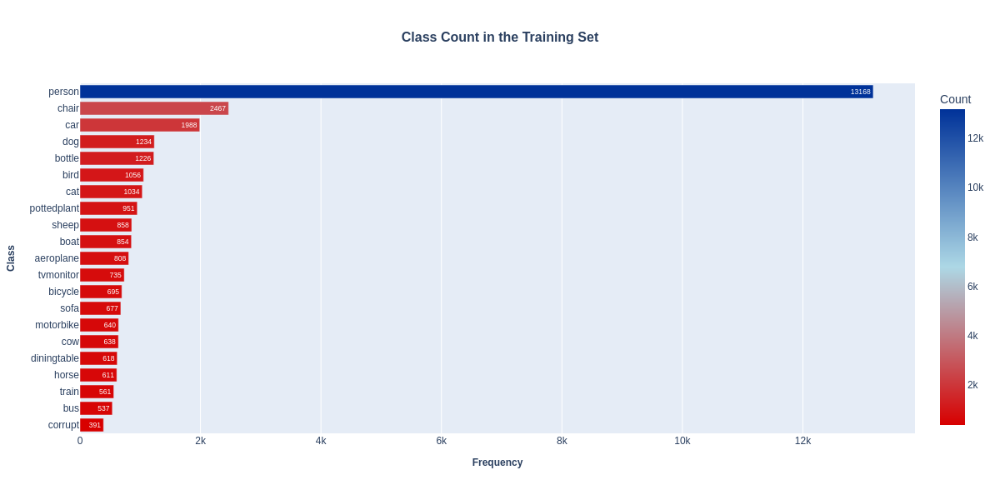

In [ ]:
#plot_counts(num_train_instances) In this case, it is not strictly necessary to create interactive graphs
plot_counts(num_train_instances, renderer="png")

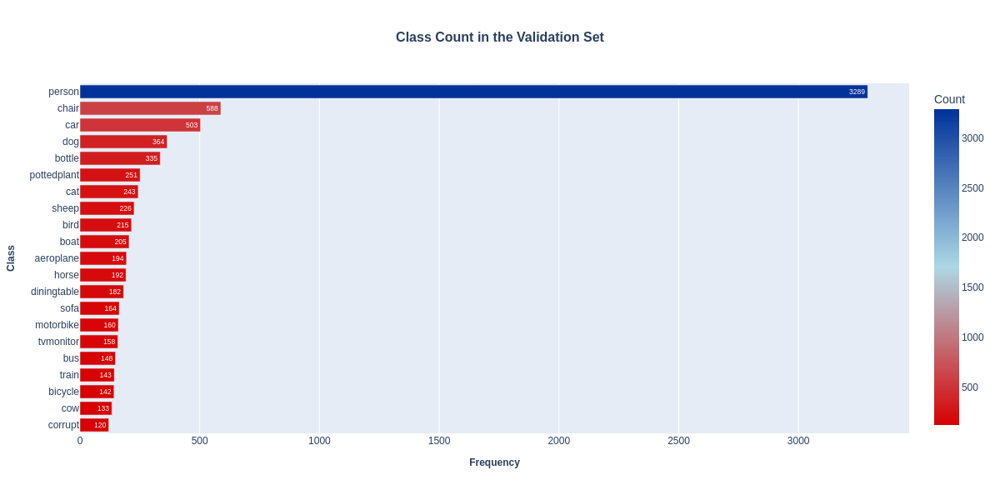

In [ ]:
#plot_counts(num_val_instances)
plot_counts(num_val_instances, split="validation", renderer="png")

In [ ]:
((391 + 120) / 17112) * 100

2.986208508648901

It can be seen that both the training and validation datasets are unbalanced. The ``person`` class has the highest number of instances in the images of both sets, with a significant difference compared to the other classes. In contrast, the ``bus`` class (in the training dataset) and the ``cow`` class (in the validation dataset) have the fewest instances. It is also noted that there are very few corrupt files, less than 3% of the total, which will practically not affect the model's performance after their removal. Given the significant imbalance in the dataset, one might conclude that the model's performance would be biased towards the majority classes. However, this will not be an issue, as will be discussed later, due to the **Distribution Focal Loss** applied to the YOLO models from Ultralytics, which mitigates the imbalances among the classes.

### **Creating the YAML File**

To train an Ultralytics model, it is necessary to create a YAML file that includes the paths to the training and validation datasets, as well as the number of classes and the names of each class.

In [ ]:
# Remove the 'corrupt' class
class_names = class_names[class_names != "corrupt"].tolist()
num_classes = len(class_names)
num_classes

20

In [ ]:
with open(os.path.join(path_dataset, "data.yaml"), "w") as f:
  f.write(f"""
  path: PascalVOC
  train: train/images
  val: valid/images

  nc: {num_classes}
  names: {class_names}
  """)

### **Visualization Example**

Next, an example of the training dataset is manually plotted. With Ultralytics, data augmentation, training, and inference are very straightforward processes, so it won't even be necessary to plot the images with their respective bounding boxes, as will be demonstrated later.

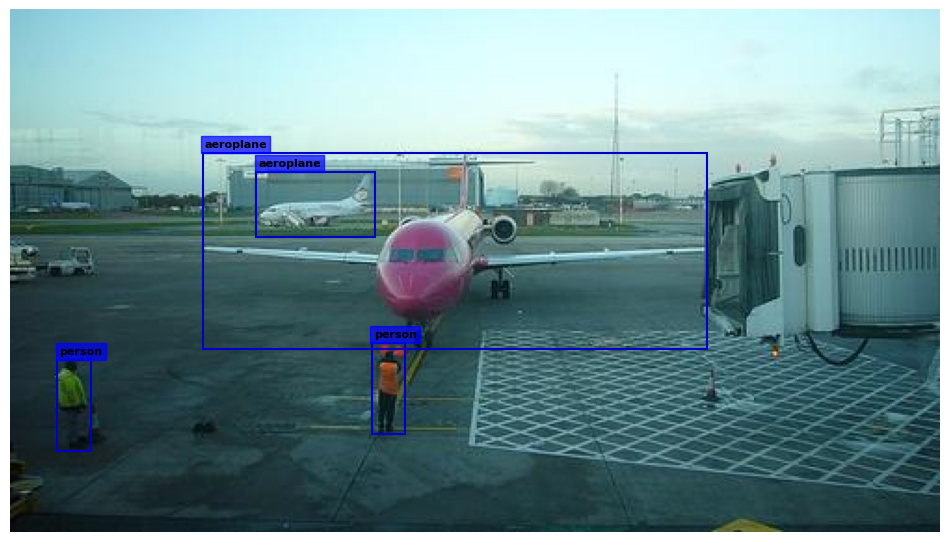

In [ ]:
fig, ax = plt.subplots(1, figsize=(12, 10))

image = Image.open("/content/datasets/PascalVOC/train/images/2007_000032_jpg.rf.453cf71521fb73718369a7f07a41433c.jpg")
image = np.array(image)
shape = image.shape
ax.imshow(image)

annotation = np.loadtxt("/content/datasets/PascalVOC/train/labels/2007_000032_jpg.rf.453cf71521fb73718369a7f07a41433c.txt")
annotation = annotation[None, :] if annotation.ndim == 1 else annotation
classes = annotation[:, 0]
boxes = annotation[:, 1:]

for i in range(len(boxes)):
  box = boxes[i]
  cls = classes[i].astype(np.int32)

  x_center, y_center, width, height = tuple(box)
  xmin = (x_center - width / 2) * shape[1]
  ymin = (y_center - height / 2) * shape[0]
  xmax = (x_center + width / 2) * shape[1]
  ymax = (y_center + height / 2) * shape[0]

  rect = patches.Rectangle((xmin, ymin), xmax-xmin, ymax-ymin, linewidth=1.5, edgecolor="mediumblue", facecolor="none")
  ax.add_patch(rect)

  ax.text(
      x=xmin+shape[1]*0.002, y=ymin-shape[0]*0.007, s=f"{class_names[cls]}",
      color="black", fontsize=8, fontweight="bold", ha="left", va="bottom",
      bbox={"boxstyle":"square", "facecolor": "blue", "edgecolor":"blue", "alpha":0.7}
  )

ax.axis("off");

## **Initializing and Training the Model**

The YOLO model downloaded from the Ultralytics GitHub is a **PyTorch** model, meaning it cannot currently be trained on Colab's TPU to accelerate the process. In this case, the specific version used is **YOLO11l**, which has over 25 million parameters. The decision is made to freeze the 11 layers of the model's backbone, significantly improving accuracy on both the training and validation datasets while nearly halving the training time. With Ultralytics, it is not necessary to specify the optimizer and learning rate, as these are automatically selected based on the dataset size and the number of epochs. However, in this case, I have chosen to specify them because experimentation has shown that this slightly enhances the model's performance compared to the automatic values. The ``AdamW`` optimizer is selected with a learning rate of ``1e-5``.

Regarding data augmentation to make the model more robust and prevent overfitting, with Ultralytics, it is simply a matter of adjusting the values of each transformation since everything is implemented with the [Albumentations](https://albumentations.ai/), [OpenCV](https://opencv.org/) and [Torchvision](https://pytorch.org/vision/stable/index.html) libraries.

During training, the YOLO model uses the following three losses:

- **box_loss**: This is the **Complete Intersection over Union (CIoU) Loss**. This loss function considers not only the overlap between the predicted and actual bounding boxes but also the distance between their centers and the aspect ratio. This makes it a more thorough metric for assessing box alignment. It surpasses the performance of IoU (Intersection over Union), GIoU (Generalized IoU), and DIoU (Distance IoU) losses.

- **cls_loss**: This is the **Binary Cross Entropy loss with logits** applied to the model's classifier.

- **dfl_loss**: This refers to the **Distribution Focal Loss (DFL)**, an enhanced variant of the focal loss aimed at giving greater emphasis to difficult-to-classify instances. It modifies the focal loss according to the class distribution, enhancing the model's sensitivity to minority classes and helping to address class imbalance.

Finally, since the training time for YOLO models can be lengthy, Ultralytics also provides options to resume training from where it left off, which is useful in case of interruptions or if the free GPU time of 3 hours and 40 minutes on Google Colab is exceeded. However, in this case, it will not be necessary, as the training will last **3.176 hours** thanks to the freezing of the backbone.

In [ ]:
## @title Choose Whether to Resume Training
pretrained = False # @param {type:"boolean"}

In [ ]:
name_project = os.path.join(path_save_results, "ObjectDetection_YOLO11l_PascalVOC")

In [ ]:
if pretrained:
  model = YOLO(os.path.join(name_project, "weights/last.pt"))
else:
  model = YOLO("yolo11l.pt")

model.info()

100%|██████████| 49.0M/49.0M [00:00<00:00, 285MB/s]


YOLO11l summary: 631 layers, 25,372,160 parameters, 0 gradients, 87.6 GFLOPs


(631, 25372160, 0, 87.6134912)

In [ ]:
if pretrained:
  results = model.train(resume=True)

else:
  results = model.train(
      data=os.path.join(path_dataset, "data.yaml"),
      epochs=epochs,
      patience=patience,
      batch=batch_size,
      optimizer="AdamW",
      lr0=1e-5,
      lrf=0.01, #Learning rate of the last epoch, which in this case is 1e-7
      momentum=0.9,
      imgsz=640,
      freeze=11, #Freeze the 11 layers of the backbone
      deterministic=True, #Allows for reproducibility of the training
      verbose=False,
      project=path_save_results,
      name=name_project,

  # Data Augmentation
      hsv_h=0.015, #Randomly adjusts the hue of the image within the range [1-0.015; 1+0.015]
      hsv_s=0.3, #Randomly adjusts the saturation of the image within the range [1-0.3; 1+0.3]
      hsv_v=0.4, #Randomly adjusts the brightness of the image within the range [1-0.4; 1+0.4]
      translate=0.1, #Randomly shifts the image horizontally and vertically by up to 10% of its original size
      scale=0.25, #Randomly scales the image size within the range of [100%-25%; 100%+25%]
      fliplr=0.5, #Horizontal flip of the image with a probability of 0.5
      mosaic=1.0, #Combines 4 images into one with a probability of 1
      close_mosaic=0, #Allows applying the mosaic in all epochs
      erasing=0.25 #25% probability of applying random erasure using 'torchvision.transforms.RandomErasing'
  )

Ultralytics 8.3.4 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolo11l.pt, data=/content/datasets/PascalVOC/data.yaml, epochs=25, time=None, patience=5, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=/content/drive/MyDrive/Ultralytics, name=ObjectDetection_YOLO11l_PascalVOC, exist_ok=False, pretrained=True, optimizer=AdamW, verbose=False, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=0, resume=False, amp=True, fraction=1.0, profile=False, freeze=11, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=Fal

100%|██████████| 5.35M/5.35M [00:00<00:00, 97.0MB/s]


AMP: checks passed ✅


train: Scanning /content/datasets/PascalVOC/train/labels... 13299 images, 0 backgrounds, 0 corrupt: 100%|██████████| 13299/13299 [00:07<00:00, 1880.60it/s]


train: New cache created: /content/datasets/PascalVOC/train/labels.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


/usr/local/lib/python3.10/dist-packages/albumentations/__init__.py:13: UserWarning: A new version of Albumentations is available: 1.4.17 (you have 1.4.15). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
  check_for_updates()
val: Scanning /content/datasets/PascalVOC/valid/labels... 3302 images, 0 backgrounds, 0 corrupt: 100%|██████████| 3302/3302 [00:02<00:00, 1112.75it/s]

val: New cache created: /content/datasets/PascalVOC/valid/labels.cache


Plotting labels to /content/drive/MyDrive/Ultralytics/ObjectDetection_YOLO11l_PascalVOC/labels.jpg... 
optimizer: AdamW(lr=1e-05, momentum=0.9) with parameter groups 167 weight(decay=0.0), 174 weight(decay=0.0005), 173 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to /content/drive/MyDrive/Ultralytics/ObjectDetection_YOLO11l_PascalVOC
Starting training for 25 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/25      4.66G     0.8816      1.365       1.28         14        640: 100%|██████████| 832/832 [07:06<00:00,  1.95it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 104/104 [00:51<00:00,  2.02it/s]


                   all       3302       7835      0.714      0.673      0.725       0.56

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/25      4.61G     0.8214      1.125      1.234         27        640: 100%|██████████| 832/832 [07:12<00:00,  1.92it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 104/104 [00:48<00:00,  2.15it/s]


                   all       3302       7835      0.754      0.706      0.771      0.618

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/25      4.59G      0.778       1.03      1.209         17        640: 100%|██████████| 832/832 [06:49<00:00,  2.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 104/104 [00:48<00:00,  2.17it/s]


                   all       3302       7835      0.778      0.727      0.795      0.646

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/25      4.69G     0.7515      0.981      1.193         13        640: 100%|██████████| 832/832 [06:43<00:00,  2.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 104/104 [00:48<00:00,  2.12it/s]


                   all       3302       7835       0.77      0.736        0.8      0.656

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/25      4.82G     0.7396     0.9551      1.179         12        640: 100%|██████████| 832/832 [06:43<00:00,  2.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 104/104 [00:49<00:00,  2.12it/s]


                   all       3302       7835      0.794      0.727      0.806      0.659

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/25      4.48G      0.737     0.9278       1.18         17        640: 100%|██████████| 832/832 [06:40<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 104/104 [00:49<00:00,  2.11it/s]


                   all       3302       7835      0.766      0.748      0.808      0.664

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/25      4.59G     0.7295      0.915      1.179         16        640: 100%|██████████| 832/832 [06:42<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 104/104 [00:48<00:00,  2.13it/s]

                   all       3302       7835      0.774      0.745      0.811      0.665



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/25      4.47G     0.7263     0.9052      1.176         11        640: 100%|██████████| 832/832 [06:41<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 104/104 [00:48<00:00,  2.16it/s]


                   all       3302       7835      0.786      0.736      0.814      0.668

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/25      4.59G      0.721     0.8994      1.167         20        640: 100%|██████████| 832/832 [06:43<00:00,  2.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 104/104 [00:47<00:00,  2.17it/s]


                   all       3302       7835      0.788      0.741      0.812      0.667

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/25      4.53G     0.7164     0.8876      1.164         14        640: 100%|██████████| 832/832 [06:45<00:00,  2.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 104/104 [00:50<00:00,  2.05it/s]


                   all       3302       7835      0.769      0.753      0.812      0.667

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/25      4.82G     0.7161     0.8768      1.158          8        640: 100%|██████████| 832/832 [06:44<00:00,  2.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 104/104 [00:47<00:00,  2.17it/s]


                   all       3302       7835      0.785      0.743      0.817      0.672

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/25      4.59G     0.7078     0.8681      1.152         11        640: 100%|██████████| 832/832 [06:46<00:00,  2.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 104/104 [00:48<00:00,  2.16it/s]


                   all       3302       7835      0.794      0.743      0.819      0.676

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/25       4.5G     0.7048     0.8602      1.156         14        640: 100%|██████████| 832/832 [06:42<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 104/104 [00:48<00:00,  2.13it/s]


                   all       3302       7835      0.786      0.759      0.819      0.676

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/25      4.41G     0.6957     0.8531       1.15         14        640: 100%|██████████| 832/832 [06:42<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 104/104 [00:48<00:00,  2.17it/s]


                   all       3302       7835      0.783      0.752       0.82      0.677

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/25       4.5G     0.6998     0.8468       1.15         24        640: 100%|██████████| 832/832 [06:42<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 104/104 [00:48<00:00,  2.13it/s]


                   all       3302       7835      0.786      0.753       0.82      0.676

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/25      4.82G      0.693     0.8408      1.146         16        640: 100%|██████████| 832/832 [06:46<00:00,  2.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 104/104 [00:48<00:00,  2.13it/s]


                   all       3302       7835      0.775      0.762       0.82      0.679

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/25      4.52G     0.6983     0.8409      1.148         27        640: 100%|██████████| 832/832 [06:44<00:00,  2.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 104/104 [00:49<00:00,  2.10it/s]


                   all       3302       7835      0.772      0.761       0.82      0.678

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/25      4.58G     0.6917     0.8323      1.143         10        640: 100%|██████████| 832/832 [06:42<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 104/104 [00:49<00:00,  2.10it/s]

                   all       3302       7835      0.799      0.736      0.821      0.678



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/25       4.6G      0.688     0.8313      1.142         17        640: 100%|██████████| 832/832 [06:41<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 104/104 [00:49<00:00,  2.08it/s]


                   all       3302       7835      0.789      0.756      0.822      0.679

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/25       4.5G     0.6889     0.8232      1.141          6        640: 100%|██████████| 832/832 [06:42<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 104/104 [00:48<00:00,  2.16it/s]


                   all       3302       7835       0.79      0.758       0.82      0.678

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/25      4.62G     0.6804     0.8209      1.139          7        640: 100%|██████████| 832/832 [06:41<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 104/104 [00:48<00:00,  2.17it/s]


                   all       3302       7835      0.801      0.749      0.822       0.68

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/25      4.48G     0.6793      0.815      1.139         10        640: 100%|██████████| 832/832 [06:43<00:00,  2.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 104/104 [00:49<00:00,  2.11it/s]


                   all       3302       7835      0.802      0.746      0.823      0.679

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/25      4.49G     0.6832     0.8136      1.137         17        640: 100%|██████████| 832/832 [06:41<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 104/104 [00:48<00:00,  2.16it/s]


                   all       3302       7835       0.79      0.754      0.823      0.679

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/25      4.47G     0.6779     0.8152      1.136         17        640: 100%|██████████| 832/832 [06:58<00:00,  1.99it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 104/104 [00:49<00:00,  2.09it/s]


                   all       3302       7835      0.784      0.757      0.823      0.679

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/25      4.46G     0.6789     0.8088      1.135         12        640: 100%|██████████| 832/832 [06:41<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 104/104 [00:48<00:00,  2.12it/s]


                   all       3302       7835      0.791      0.756      0.824      0.681

25 epochs completed in 3.176 hours.
Optimizer stripped from /content/drive/MyDrive/Ultralytics/ObjectDetection_YOLO11l_PascalVOC/weights/last.pt, 51.2MB
Optimizer stripped from /content/drive/MyDrive/Ultralytics/ObjectDetection_YOLO11l_PascalVOC/weights/best.pt, 51.2MB

Validating /content/drive/MyDrive/Ultralytics/ObjectDetection_YOLO11l_PascalVOC/weights/best.pt...
Ultralytics 8.3.4 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLO11l summary (fused): 464 layers, 25,294,732 parameters, 0 gradients, 86.7 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 104/104 [00:51<00:00,  2.01it/s]


                   all       3302       7835      0.791      0.756      0.823       0.68
Speed: 0.2ms preprocess, 10.4ms inference, 0.0ms loss, 1.2ms postprocess per image
Results saved to /content/drive/MyDrive/Ultralytics/ObjectDetection_YOLO11l_PascalVOC


## **Model Evaluation**

Upon completing the training, Ultralytics automatically evaluates the model's performance on the validation dataset, generating performance metrics and their corresponding graphs. Among the most important metrics are the following:

- **Precision (Box):** This metric measures the proportion of correct predictions among all predictions made by the model. It is calculated as the number of true positives (TP) divided by the sum of true positives and false positives (FP).

  - **True Positives (TP):** A true positive is considered when the predicted bounding box and the ground truth box have an Intersection over Union (IoU) of at least 0.5 and belong to the same class. This means the model has not only detected the presence of an object but has also accurately located its position and category.
  
  - **False Positives (FP):** A false positive occurs when the model predicts that an object is present (i.e., it generates a bounding box), but there is actually no corresponding object in the image, or the detected object does not match the real class.

  - **False Negatives (FN):** A false negative occurs when the model fails to detect an object that is present in the image. This means there is a real box, but the model does not generate any corresponding prediction for that object.

- **Recall (Box):** This metric measures the proportion of correctly detected objects among all objects that are actually present in the image. It is calculated as the number of true positives (TP) divided by the sum of true positives and false negatives (FN).

- **mAP50:** The mean Average Precision at an IoU threshold of 0.5, where Average Precision (AP) computes the area under the precision-recall curve. This metric provides an overview of the model's ability to accurately detect objects by averaging precision across different classes, with the IoU threshold fixed at 0.5. This is a standard metric used in the COCO dataset evaluation.

- **mAP50-95:** The mean Average Precision across multiple IoU thresholds ranging from 0.5 to 0.95, incremented by 0.05. This metric offers a more comprehensive assessment of the model's performance, considering varying levels of object localization precision. Similar to mAP50, this metric is also employed in COCO evaluations, allowing for a standardized comparison across different models.

All these metrics range from **0** to **1**. A value of **0** indicates poor performance (no correct predictions), while a value of **1** indicates perfect performance (all predictions are correct).

### **Loss and Metrics Graphs**

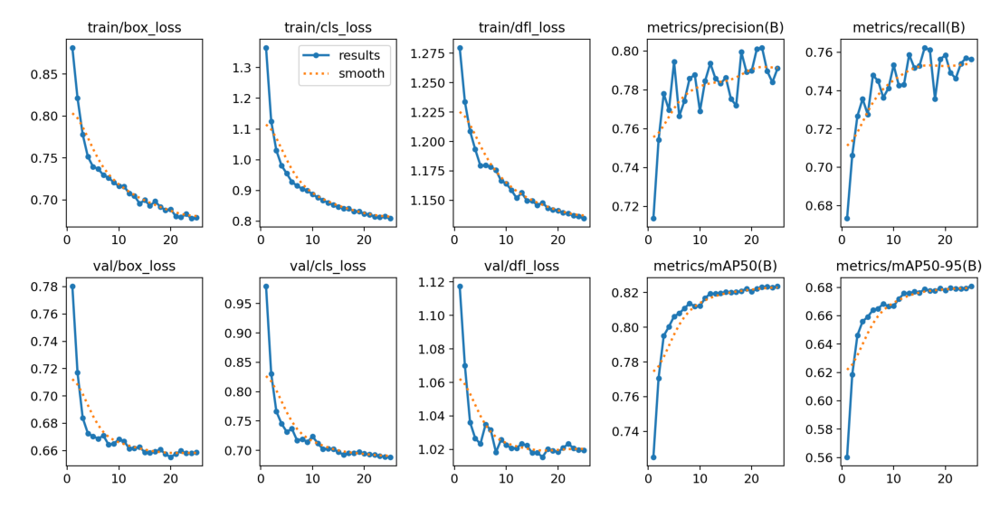

In [ ]:
plt.figure(figsize=(14, 8))

img = Image.open(os.path.join(name_project, "results.png"))
plt.imshow(img)
plt.axis("off");

It can be observed that the mAP50 and mAP50-95 metrics for the validation dataset increase only slightly in the last epochs, showing signs of plateauing. This indicates that the model has reached its optimal performance at 25 epochs, having successfully converged. Training for more epochs would not provide significant improvements, suggesting that the learning rate has been appropriately chosen, allowing the model to reach its full potential in just 25 epochs.

### **Detailed Evaluation of the Validation Dataset**

Although the model automatically generates validation metrics and graphs upon completing the training, this evaluation can also be performed using ``model.eval()``. By adding the argument ``verbose=True``, more detailed metrics for each class will be printed to the screen.

In [ ]:
path_eval = os.path.join(name_project, "yolo11l_eval")

In [ ]:
results = model.val(
    data=os.path.join(path_dataset, "data.yaml"),
    name=path_eval,
    verbose=True
)

Ultralytics 8.3.4 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLO11l summary (fused): 464 layers, 25,294,732 parameters, 0 gradients, 86.7 GFLOPs


val: Scanning /content/datasets/PascalVOC/valid/labels.cache... 3302 images, 0 backgrounds, 0 corrupt: 100%|██████████| 3302/3302 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 207/207 [01:38<00:00,  2.10it/s]


                   all       3302       7835      0.789      0.757      0.823      0.681
             aeroplane        134        194       0.92      0.833      0.912      0.792
               bicycle        107        142       0.66      0.712      0.742      0.626
                  bird        146        215      0.859      0.791      0.856      0.694
                  boat        124        205      0.835      0.718      0.819      0.593
                bottle        166        335       0.64      0.632      0.637      0.466
                   bus         95        148      0.885      0.832      0.901      0.792
                   car        271        503      0.742      0.744      0.822      0.648
                   cat        215        243      0.916      0.901      0.945      0.862
                 chair        257        588      0.682      0.609      0.697      0.538
                   cow         70        133      0.733      0.895      0.922      0.762
           diningtabl

The model has achieved an impressive **mAP50** of **0.823** and **mAP50-95** of **0.681** on the validation dataset, indicating excellent overall performance. The highest performance is seen in the `cat` and `train` classes, with mAP50 values over **0.94**, despite these classes not having the most instances in the dataset, highlighting the effectiveness of the **Distribution Focal Loss** in handling imbalanced datasets. On the other hand, the model struggles with the `bottle` and `pottedplant` classes, with mAP50 values of **0.637** and **0.651** respectively, likely due to the small size of these objects in the images.

### **Confusion Matrix**

The calculation of the confusion matrix in object detection is more complex than in image classification, as it considers not only the confidence score but also the overlap area of each prediction. Additionally, it includes a class called ``background`` that does not belong to any of the dataset classes. The confusion matrix provides a detailed analysis of the results, showing counts of true positives, false positives, and false negatives for each class, from which the precision and recall of the model in the validation set are derived.

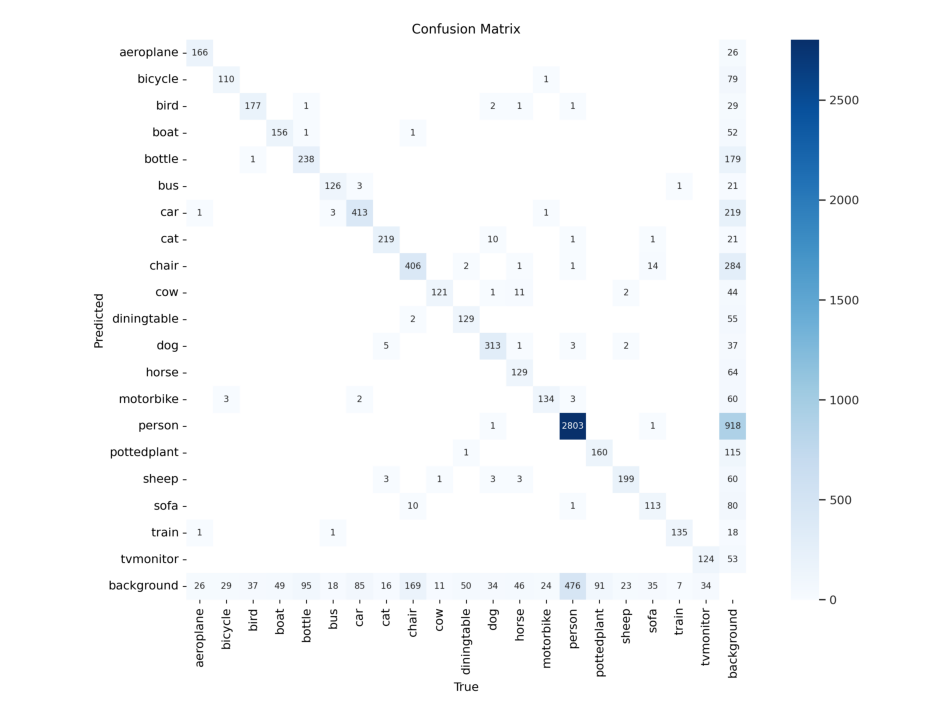

In [ ]:
plt.figure(figsize=(12, 12))

img = Image.open(os.path.join(path_eval, "confusion_matrix.png"))
plt.imshow(img)
plt.axis("off");

## **Inference with the Trained Model**

Inference with a fine-tuned Ultralytics YOLO model is straightforward, as it accepts a wide range of image and video formats for predictions. Additionally, the results are presented graphically and can be obtained in real time. All accepted formats are detailed in the official [Ultralytics documentation](https://docs.ultralytics.com/modes/predict/#inference-sources).

In [ ]:
# Load the trained model
model = YOLO(os.path.join(name_project, "weights/best.pt"))

### **Validation Dataset**

In [ ]:
# Extract all the paths of the validation images
images_val = glob(os.path.join(path_dataset, "valid/images/*jpg"))

In [ ]:
# Function for image inference
def pascal_detection(images, n_rows=2, n_cols=2, save=False, path_save=""):
  images_shuffled = images.copy()
  np.random.shuffle(images_shuffled)
  n_samples = int(n_rows*n_cols)

  results = model.predict(
      source=images_shuffled[:n_samples],
      imgsz=640,
      save=False,
      verbose=False
  )

  fig, axes = plt.subplots(n_rows, n_cols, figsize=(n_cols*5, n_rows*5))
  axes = axes.flatten() if n_samples > 1 else [axes]

  for i, result in enumerate(results):
    result = result.plot()
    result = result[..., ::-1] #Convert the image to RGB format
    axes[i].imshow(result)
    axes[i].axis("off")

  plt.tight_layout()
  # Save images
  if save:
    plt.savefig(path_save)

  plt.show()

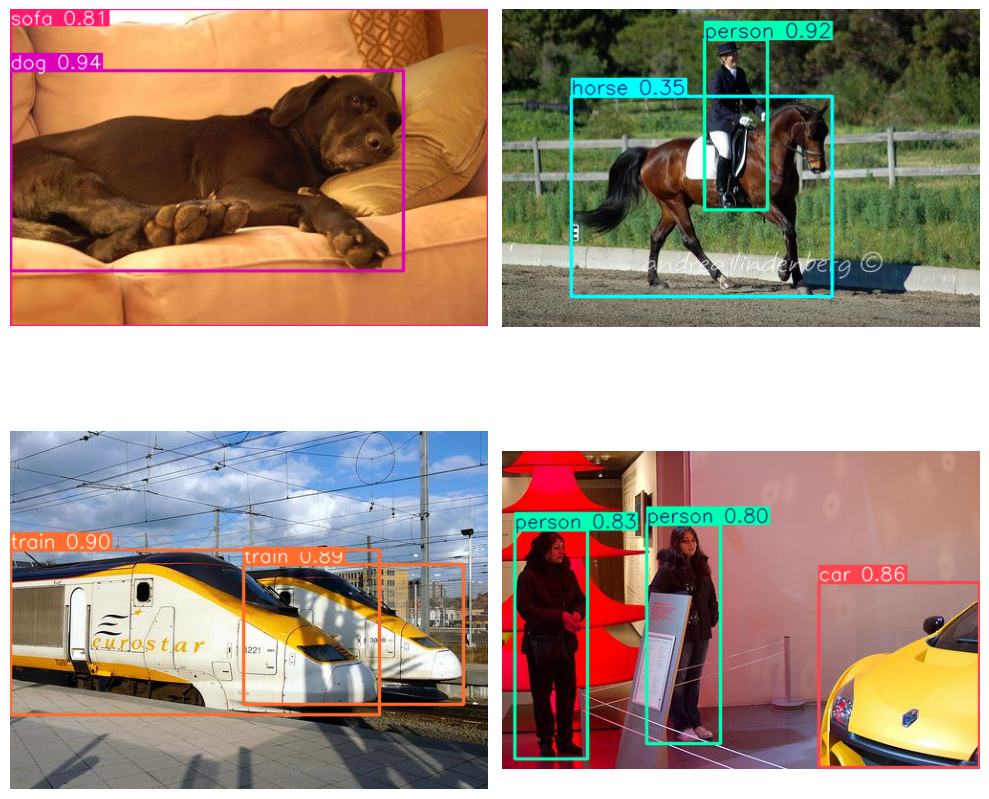

In [ ]:
pascal_detection(images_val)

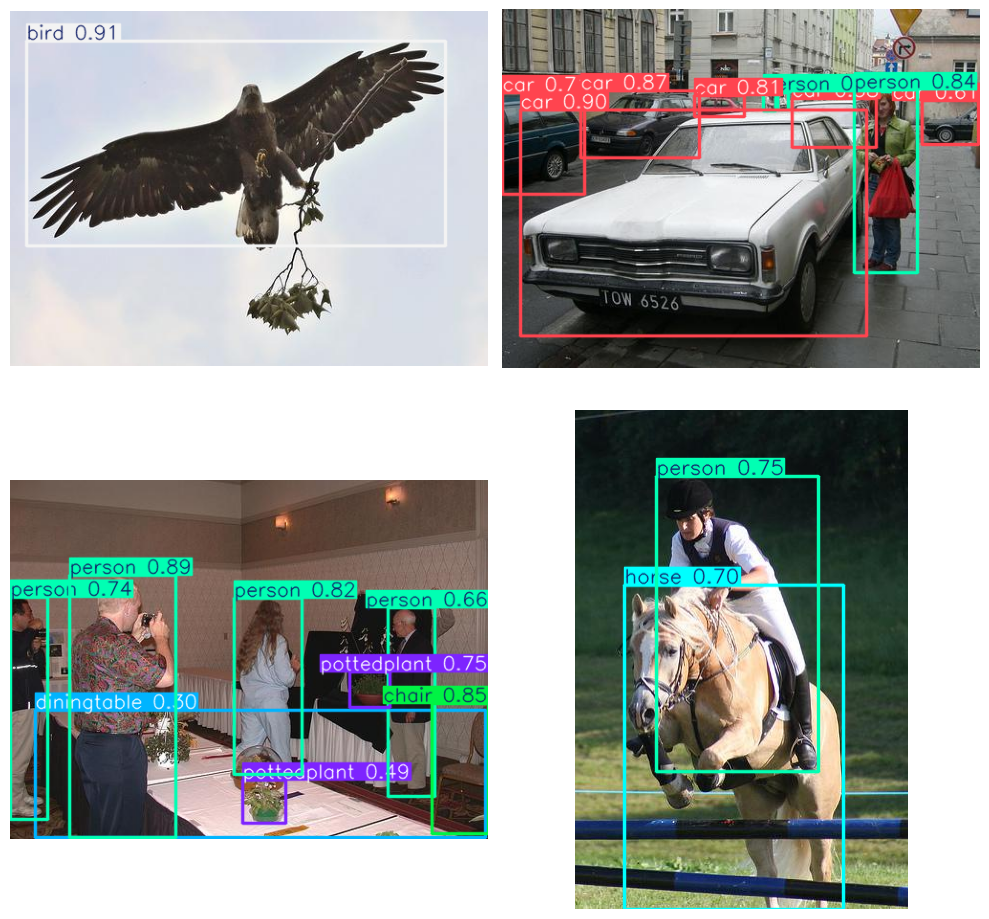

In [ ]:
pascal_detection(images_val)

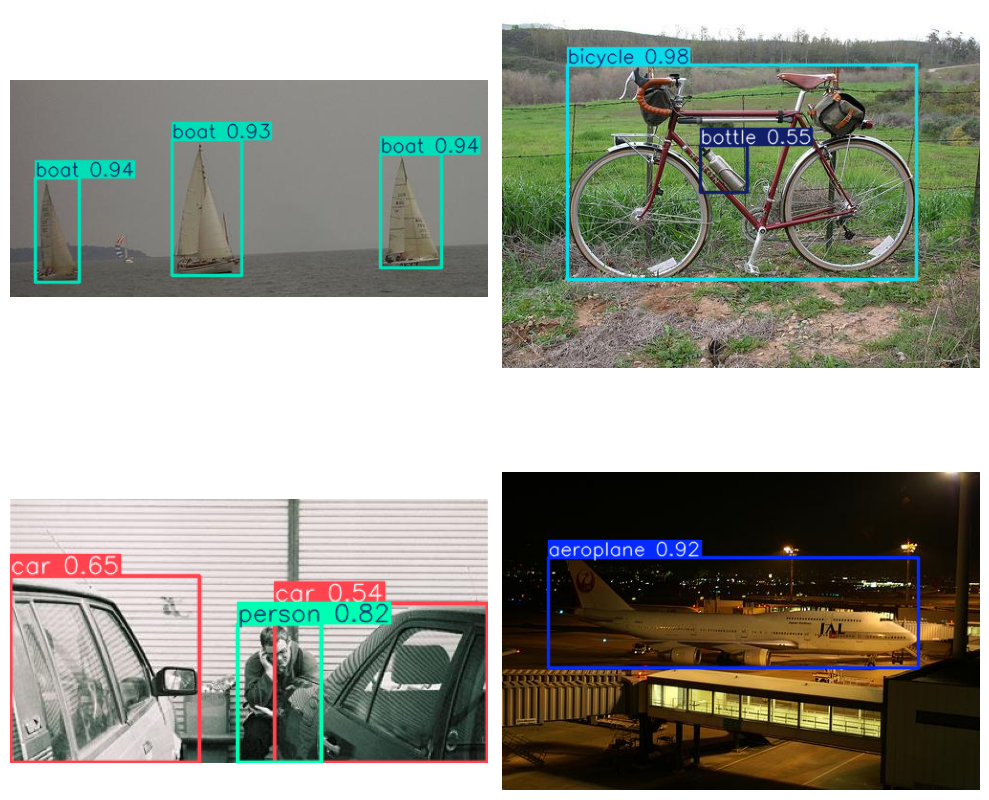

In [ ]:
pascal_detection(images_val)

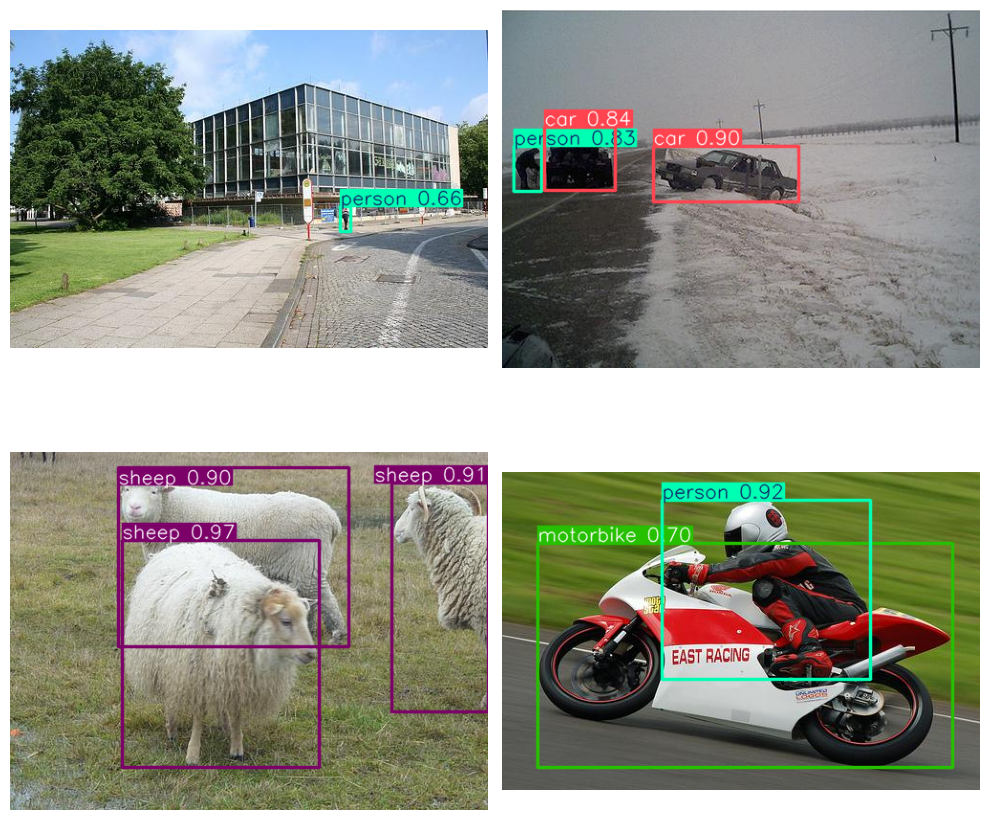

In [ ]:
pascal_detection(images_val)

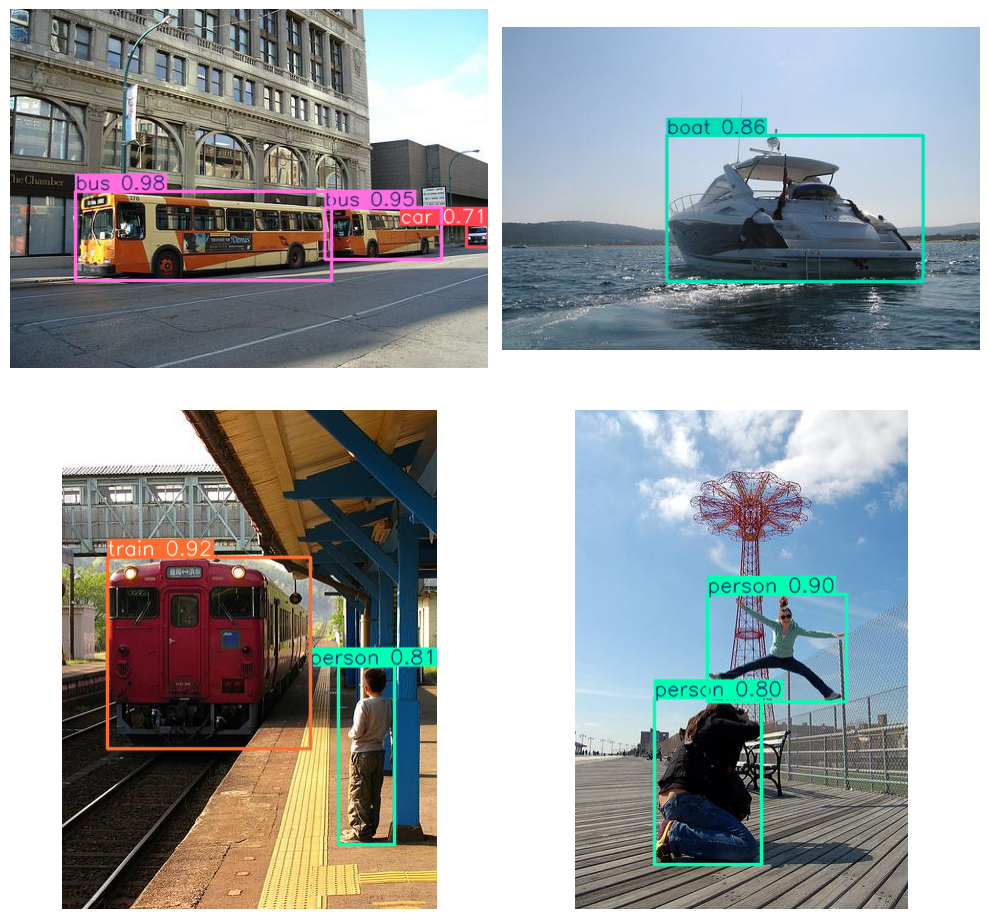

In [ ]:
pascal_detection(images_val)

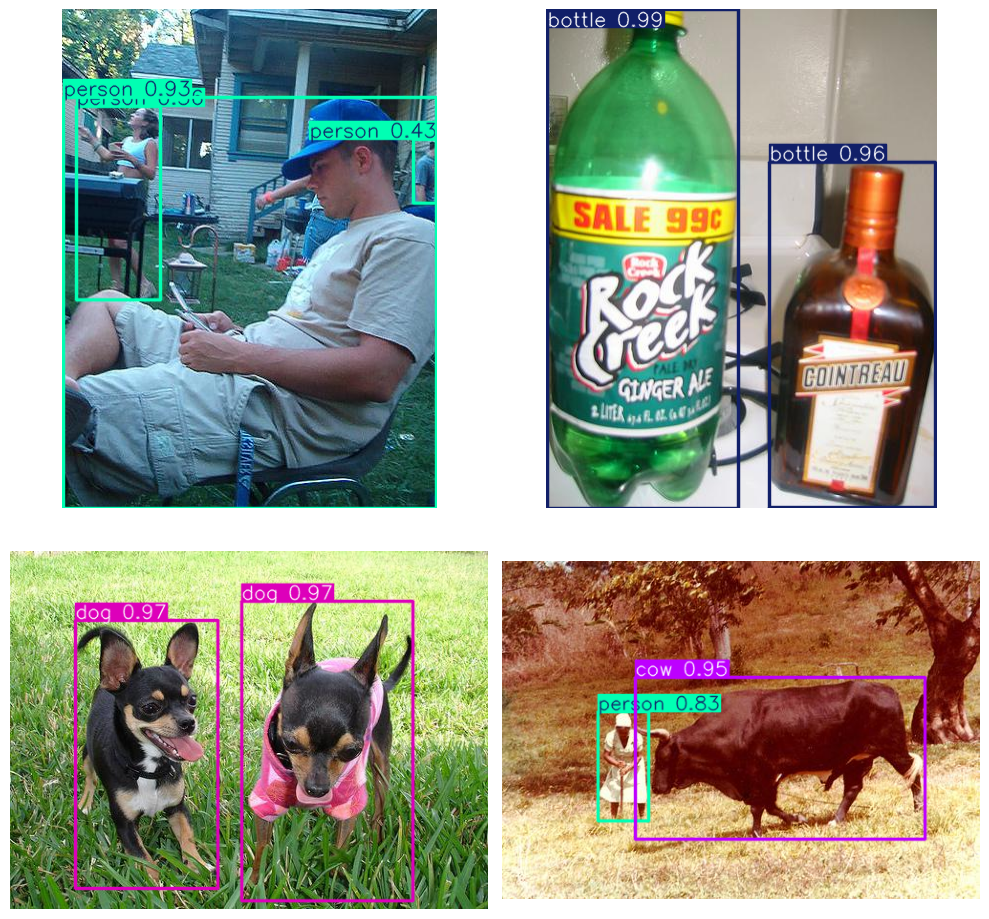

In [ ]:
pascal_detection(images_val)

### **Internet Images**

In [ ]:
url_images = [
    "https://i.dailymail.co.uk/i/pix/2013/09/23/article-2429850-1830107200000578-251_634x397.jpg",
    "https://www.theinsuranceemporium.co.uk/blog/wp-content/uploads/2024/09/shutterstock_2432338827-260x162.jpg",
    "https://3.bp.blogspot.com/-LlnfJxrh9o8/V3vEBUgk5OI/AAAAAAAAuQc/0d7E-AxdOSkg7zQzOguUMQlpiu-7Oc9jACLcB/s1600/dsc_5196_0.jpg",
    "https://akm-img-a-in.tosshub.com/businesstoday/images/story/202308/ezgif-sixteen_nine_91.jpg",

    "https://keras.io/img/guides/object_detection_keras_cv/object_detection_keras_cv_8_0.png",
    "https://static1.squarespace.com/static/53dd6676e4b0fedfbc26ea91/54b6c509e4b062126976d942/5b3a4473352f53eeeed1c9e8/1694015626604/36girlcrossingwidestreet.jpg?format=1500w",
    "https://www.ainonline.com/cdn-cgi/image/width=1200,format=webp,quality=95/https://backend.ainonline.com/sites/default/files/styles/fpsc_1200x630/public/uploads/2022/05/374-p180-avanti.1.gif?h=16a6ccf5&itok=oLXodzhW",
    "https://media.istockphoto.com/id/1159538131/photo/four-egrets-on-cow-back.jpg?s=612x612&w=0&k=20&c=y4u1lvHUEsVhqnDf96foTTtvYkS9HsxQG5rCQl8t9Tk=",

    "https://www.tamilnadutourism.tn.gov.in/img/pages/medium-desktop/take-a-ride-in-the-toy-train-1653978188_8ac904b5bdb228abad78.webp",
    "https://assets-eu-01.kc-usercontent.com/fb793c58-315a-0196-d3af-7c9c2613d52c/a1b9b944-5c94-4205-bef2-3d724704a50b/staticrearbike.jpg?w=1280&q=75&lossless=true&auto=format",
    "https://www.shutterstock.com/image-photo/friendly-brown-horse-sheep-260nw-632466644.jpg",
    "https://www.waterdrop.com/cdn/shop/files/edition-glass-social-1_256x.png?v=1686321997",

    "https://images.boats.com/resize/1/3/57/2024-yamaha-boats-255-fsh-sport-h-power-9430357-964620355-0-180620240204-0.jpg?t=1718701342000",
    "https://weezevent.com/wp-content/uploads/2023/02/10155016/organiser-cousinade.jpg",
    "https://previews.123rf.com/images/andreypopov/andreypopov1509/andreypopov150900596/45461250-hombre-joven-pel%C3%ADcula-de-observaci%C3%B3n-en-la-televisi%C3%B3n-en-la-sala-de-estar.jpg",
    "https://s3.amazonaws.com/arc-wordpress-client-uploads/infobae-wp/wp-content/uploads/2016/06/04204411/auto-moto.jpg"
]

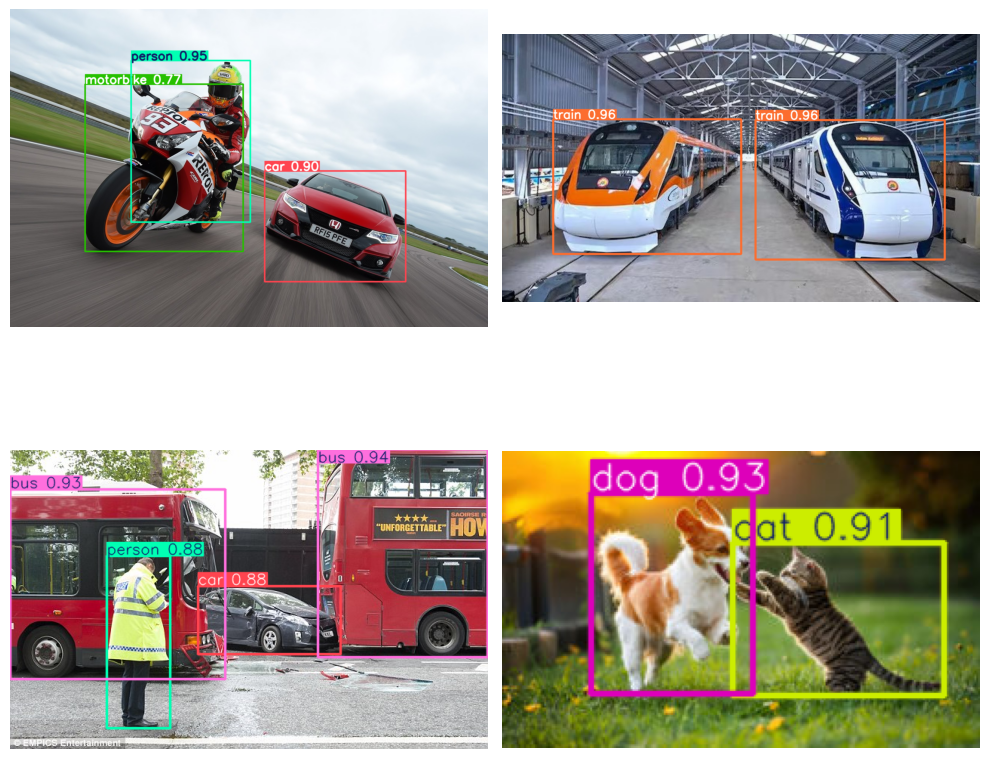

In [ ]:
pascal_detection(url_images[:4])

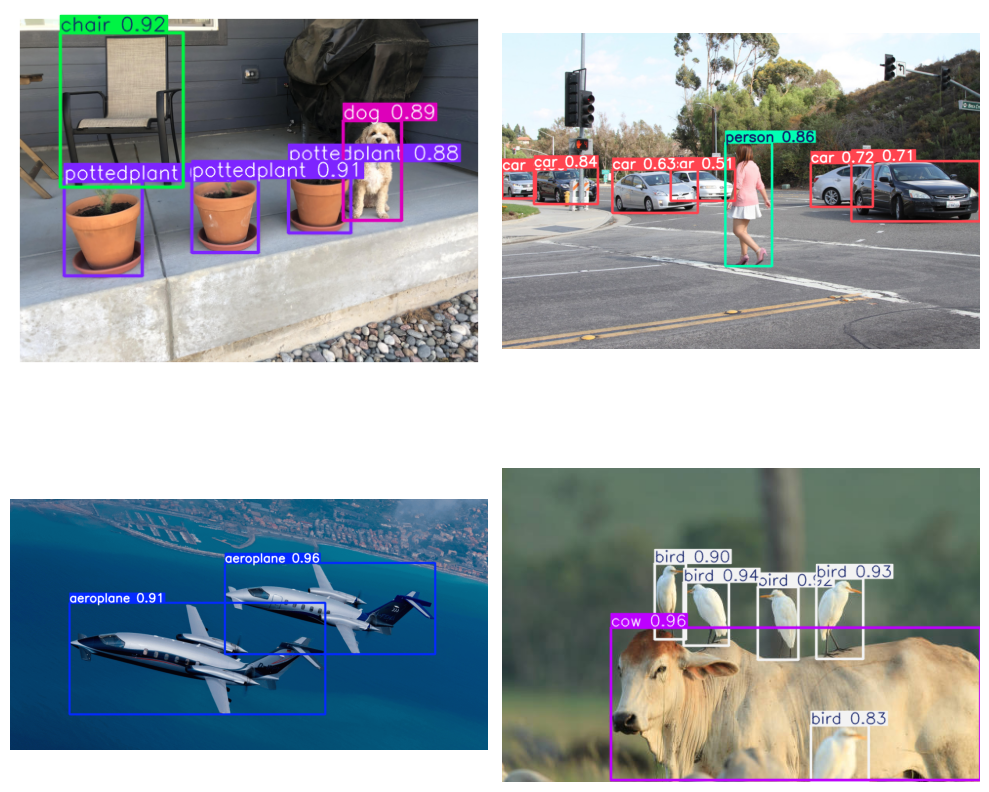

In [ ]:
pascal_detection(url_images[4:8], save=True, path_save="ObjectDetection_YOLO11l_PascalVOC_1.png")

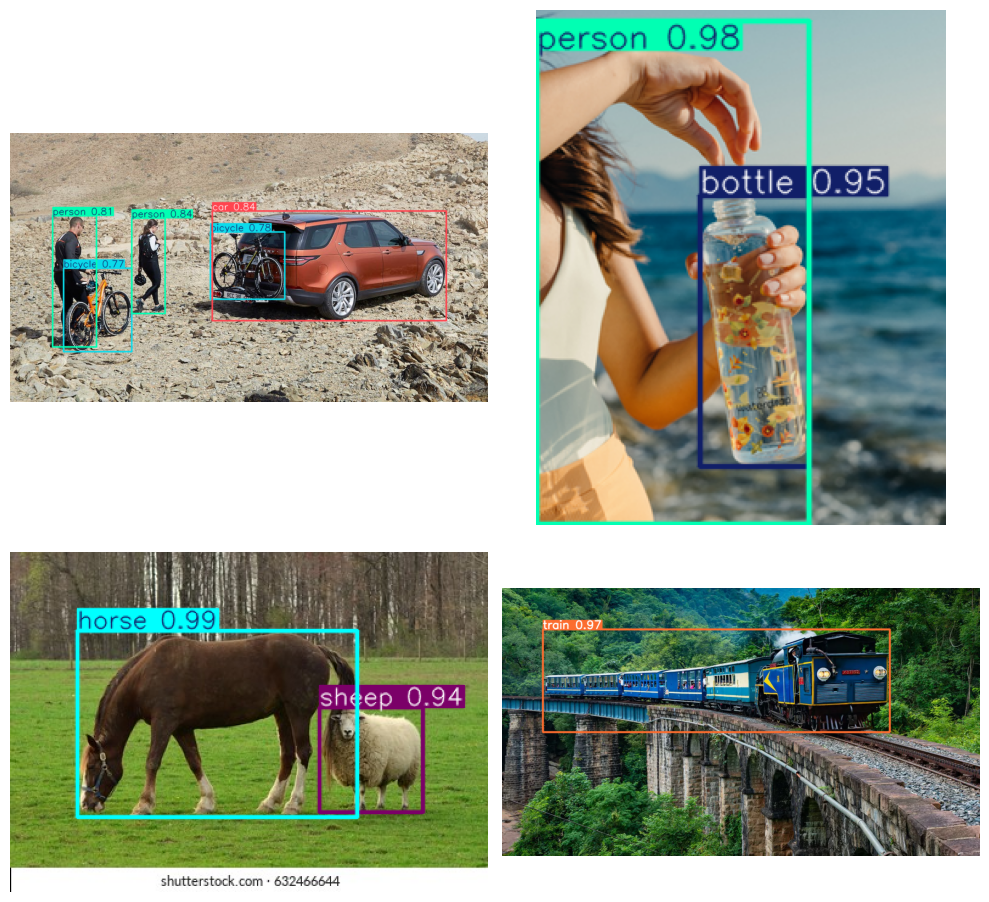

In [ ]:
pascal_detection(url_images[8:12])

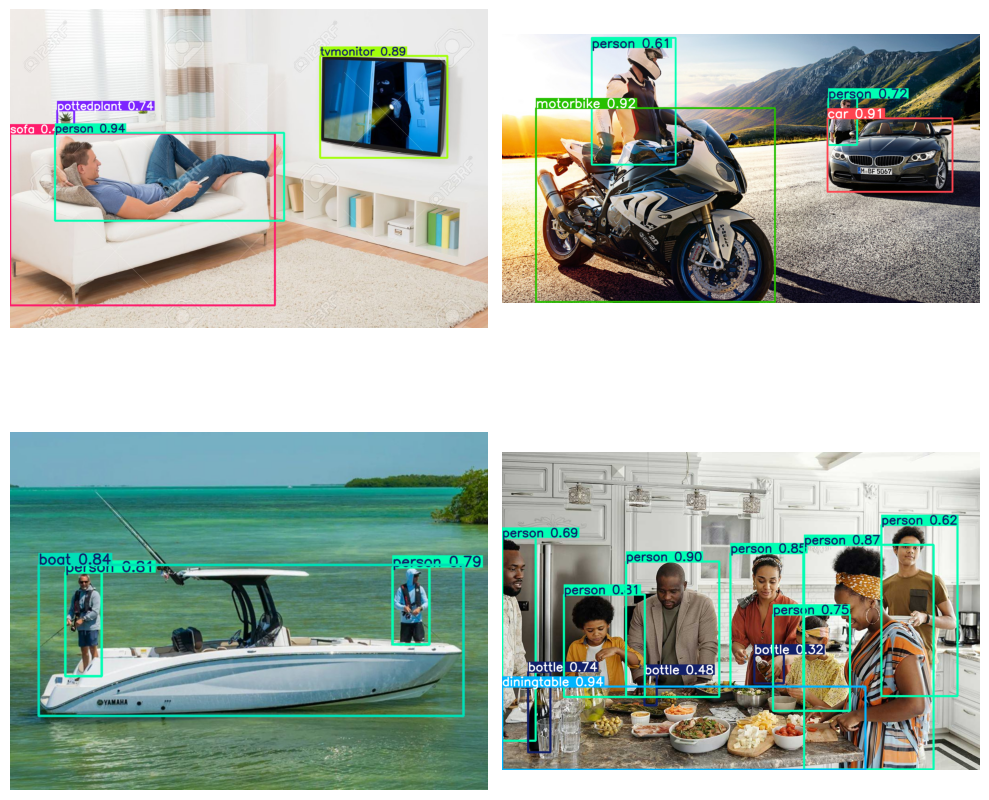

In [ ]:
pascal_detection(url_images[12:16], save=True, path_save="ObjectDetection_YOLO11l_PascalVOC_2.png")

### **Video Inference**

In [ ]:
url_video = "https://www.youtube.com/watch?v=Y1jTEyb3wiI"
path_video = "ObjectDetection_YOLO11l_PascalVOC.mp4"

In [ ]:
results = model.predict(
    source=url_video,
    stream=True,
    stream_buffer=True,
    vid_stride=4, #Stride of 4 frames to speed up prediction
    save=True,
    save_frames=False,
    verbose=False
)

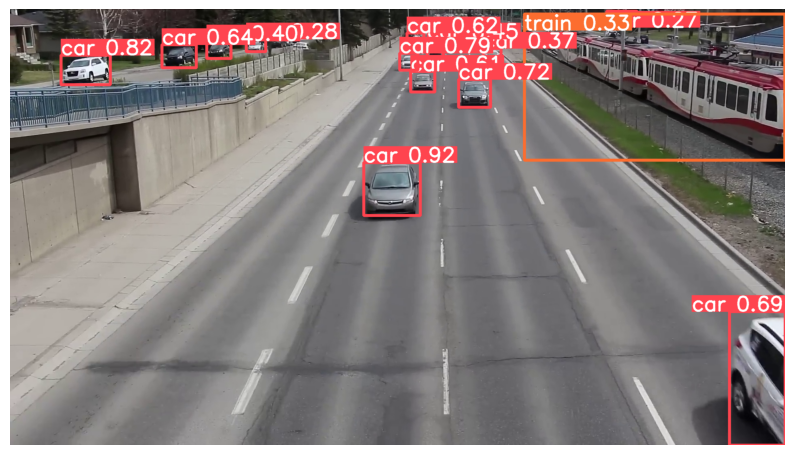

Results saved to runs/detect/predict


In [ ]:
for result in results:
  plt.figure(figsize=(10, 8))
  result = result.plot()
  result = result[..., ::-1]

  clear_output(wait=True)
  plt.imshow(result)
  plt.axis("off")
  plt.show()

In [ ]:
# Convert the video from AVI to MP4
!ffmpeg -i runs/detect/predict/watch_v_Y1jTEyb3wiI.avi $path_video -loglevel quiet -y

In [ ]:
Video(path_video, embed=True, width=600, height=400)

## **Conclusion**


The YOLO11 model fine-tuned on the PASCAL VOC 2012 dataset has achieved a **mAP50** of **0.823** and a **mAP50-95** of **0.681** on the validation set. These results are excellent and position this fine-tuning in third place according to the [Papers With Code](https://paperswithcode.com/sota/object-detection-on-pascal-voc-2012) page. This has been achieved thanks to the appropriate choice of training hyperparameters and data augmentation, as well as the freezing of the model's backbone network. The incredible performance of the Ultralytics YOLO11 model and its user-friendly interface at all stages—data augmentation, training, and inference—are also noteworthy.

